In [4]:
%load_ext autoreload
%autoreload 2
from models import weather_classifier
from tensorflow.keras.utils import to_categorical
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from dataAugmentation import WeatherImageGenerator
import numpy as np

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [7]:
x_data = np.load("images.npy")
y_data = np.load("labels.npy")

x_data = x_data / 255 # Normalize images.

label_encoder = LabelEncoder() 
y_data = label_encoder.fit_transform(y_data) # Encode images as numbers instead of strings.
y_data = to_categorical(y_data) # Create an one-hot-encoded vector for each label.

X_train, X_test, y_train, y_test = train_test_split(x_data, y_data, test_size=0.10)

In [9]:
print(x_data.shape)
x_data = np.moveaxis(x_data, -1, 1)
print(x_data.shape)

(2108, 320, 500, 5)
(2108, 5, 320, 500)


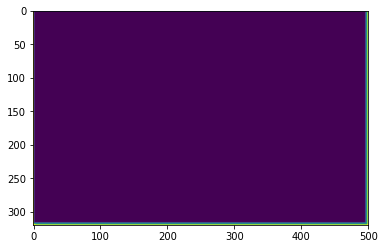

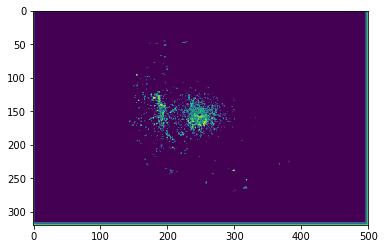

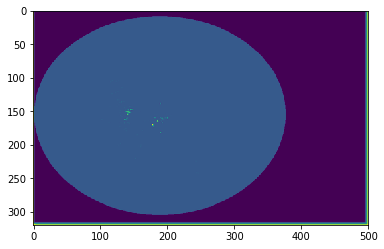

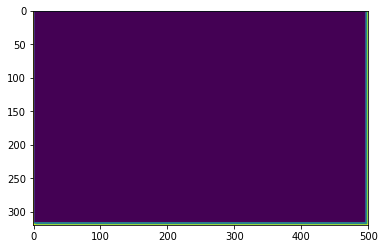

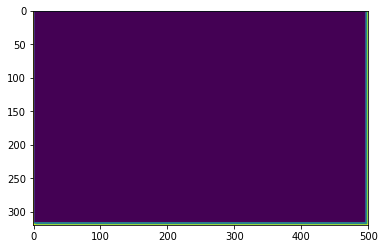

...

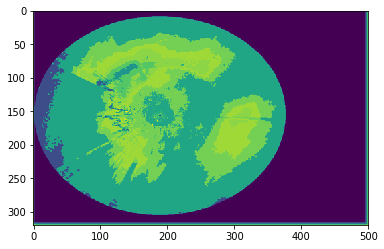

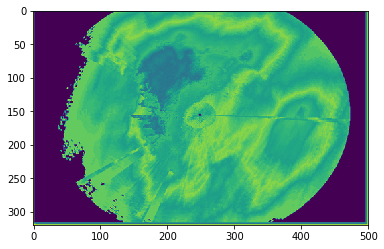

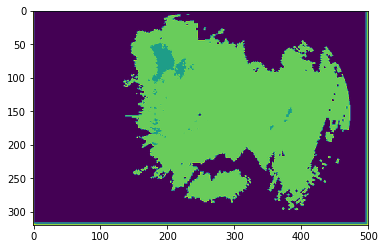

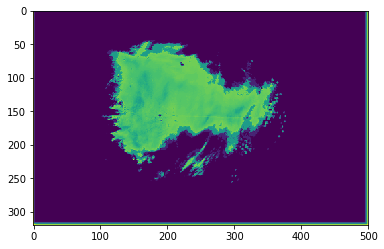

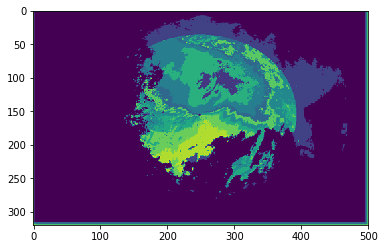

In [ ]:
import matplotlib.pyplot as plt

for i, time_step in enumerate(x_data):
    for j, image in enumerate(time_step):
        plt.imshow(image)
        plt.show()
#         print(image)
#         print(np.all(image))
        if np.all(image):
            print("Found all white image")
            x_data[i][j] = numpy.zeros((320,500), np.int8)

In [ ]:


# import matplotlib.pyplot as plt

# print(np.moveaxis(test_images[0], -1, 0).shape)

# for image in np.moveaxis(test_images[0], -1, 0):
#     print(image.shape)
#     plt.imshow(image, cmap=plt.cm.gray)
#     plt.show()

In [ ]:
num_classes = y_data.shape[1]
input_shape = x_data.shape[1:]
batch_size = 32
epochs = 30

train_generator = WeatherImageGenerator(X_train, y_train, batch_size=batch_size)

model = weather_classifier(num_classes=num_classes, input_shape=input_shape)
model.summary()

In [ ]:
model.fit_generator(train_generator, epochs=epochs, validation_data=(X_test,y_test))